# Trabajo Práctico 1 - Visión por Computadora I

## Aplicación de Coordenadas Cromáticas y White Patch

### Alumno: Domenje Carlos

### PARTE 1:

#### ✒️ Enunciado

1. Implementar el algoritmo de pasaje a coordenadas cromáticas para librarnos de las variaciones de contraste.

2. Implementar el algoritmo White Patch para librarnos de las diferencias de color de iluminación.

3. Mostrar los resultados obtenidos y analizar las posibles fallas (si es que las hay) en el caso de White patch.

### 💾 Imports de librerias necesarias 


In [1]:
#Si queremos que las imágenes sean mostradas en una ventana emergente quitar el inline
%matplotlib inline  
import warnings
warnings.filterwarnings("ignore")
# OpenCV-Python utiliza NumPy para el manejo de imágenes
import numpy as np
# cv2 es el módulo python para acceder a OpenCV 
import cv2 as cv
# Usamos las poderosas herramientas de graficación de matplotlib para mostrar imágenes, perfiles, histogramas, etc
import matplotlib.pyplot as plt

#### 🌌 Carga de imágenes para aplicación de coordenadas cromáticas.

Se realiza la lectura de las tres imagenes de la carpeta /coord_cromaticas, teniendo en cuenta que al leerlas las obtendremos en formato BGR

In [2]:
# Cargar imagenes para aplicar pasaje a coordenadas cromaticas
img_coord_1 = cv.imread('./coord_cromaticas/CoordCrom_1.png')
img_coord_2 = cv.imread('./coord_cromaticas/CoordCrom_2.png')
img_coord_3 = cv.imread('./coord_cromaticas/CoordCrom_3.png')


# Vemos los tamaños de las imágenes
print(f'Tamaño imagen: {img_coord_1.shape} pix')
print(f'Tamaño imagen: {img_coord_2.shape} pix')
print(f'Tamaño imagen: {img_coord_3.shape} pix')



Tamaño imagen: (996, 908, 3) pix
Tamaño imagen: (996, 908, 3) pix
Tamaño imagen: (996, 908, 3) pix


### 📟 Algoritmo Coordenadas Cromaticas - Implementación de clase img_to_cromathic

Se implenta la clase para luego poder generar cuantas instancias necesitemos de ella y asi poder utilizar el algoritmo para una determinada imagen que debemos cargar.

- El primer metodo que se debe utilizar el el load_img donde se debera pasarle como parametro la imagen en formato BGR.

- En segundo lugar, podremos obtener los resultados de aplicar el algoritmo llamando al metodo convert().

In [3]:
class img_to_cromathic:
    
    def load_img(self, img_input):
        self.imgRGB = cv.cvtColor(img_input, cv.COLOR_BGR2RGB)
        im_r, im_g, im_b = cv.split(self.imgRGB)
        self.img_r = np.float16(im_r)
        self.img_g = np.float16(im_g)
        self.img_b = np.float16(im_b)
        
    def convert(self):
        self.sum_colors = self.img_r + self.img_g + self.img_b
        sum_zero_check = (self.sum_colors == 0)
        
        self.img_r = np.uint8(255*self.img_r / self.sum_colors)
        self.img_r[sum_zero_check] = 0
        
        self.img_g = np.uint8(255*self.img_g / self.sum_colors)
        self.img_g[sum_zero_check] = 0
        
        self.img_b  = np.uint8(255*self.img_b  / self.sum_colors)
        self.img_b[sum_zero_check] = 0
        
        self.result_img = cv.merge((self.img_r,self.img_g,self.img_b))
        plt.figure()
        fig, splt = plt.subplots(1,2,figsize=(25,25)) 
        splt[0].imshow(self.imgRGB),   
        splt[0].set_title('Imagen Original')
        splt[1].imshow(self.result_img),
        splt[1].set_title('Imagen Aplicando Coordenadas Cromáticas ')  
        plt.show()
        

#### 💻 Aplicación de coordenadas cromaticas a imagenes cargadas - Visualización de resultados.

Se genera una instancia de la clase previamente desarrollada y se aplica para cada imagen del dataset dado los metodos correspondientes y se obtienen los resultados. 

<Figure size 640x480 with 0 Axes>

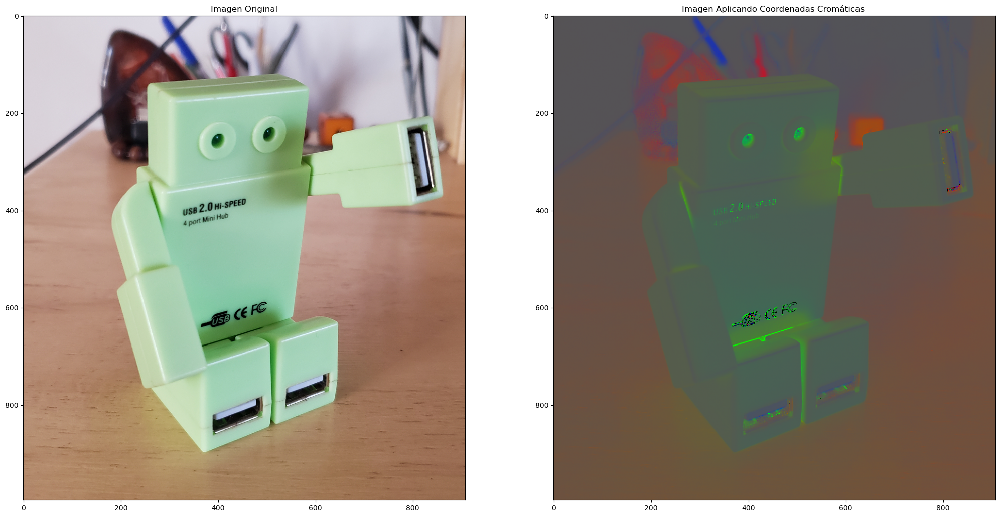

<Figure size 640x480 with 0 Axes>

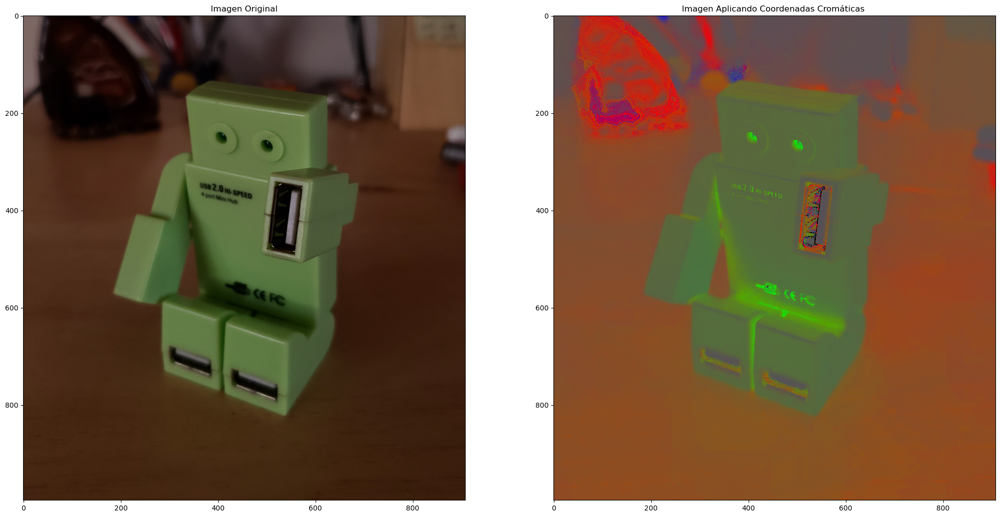

<Figure size 640x480 with 0 Axes>

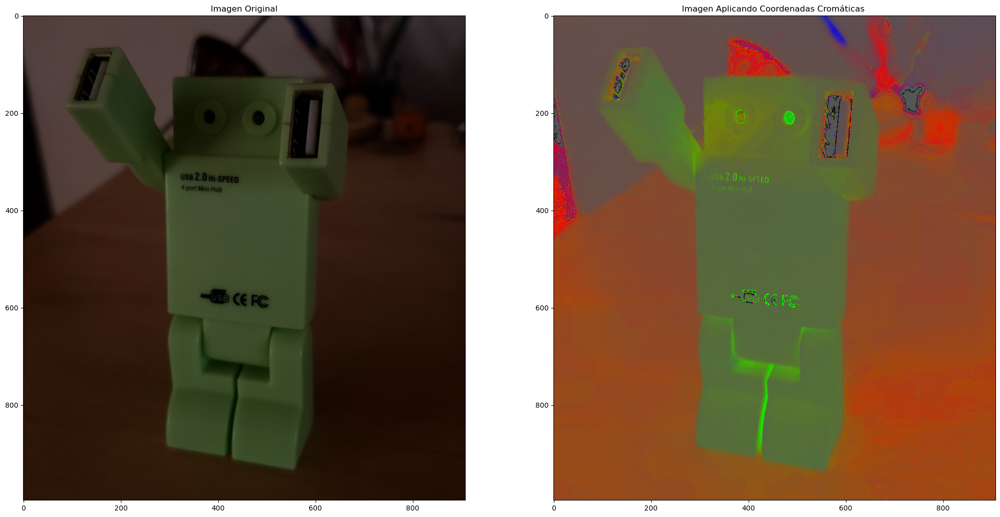

In [4]:


img2crom = img_to_cromathic()

img2crom.load_img(img_coord_1)
img2crom.convert()

img2crom.load_img(img_coord_2)
img2crom.convert()

img2crom.load_img(img_coord_3)
img2crom.convert()


### 📊 Conclusión

Como se pudo observar en las tres imagenes a las que se aplica el metodo de coordenadas cromaticas, tenemos una fuerte diferenciacion del objeto frente al fondo y los diferentes angulos donde se tomaron las fotos. En cada una de ellas se puede apreciar también que ante lugares con ausencia de luz se puede recuperar cada angulo del robot lo que hace que sea facilmente identificable. Por otro lado, este algoritmo falla en el caso que tengamos que la suma de sus 3 canales sea igual a cero, por lo que se implemento una mascara para el caso y se adopta un valor igual a cero. 


#### 📁 Import de imagenes para implementación de White Patch

In [21]:
# Cargar imagenes para aplicar pasaje a coordenadas cromaticas
img_white_patch_1 = cv.imread('./white_patch/test_blue.png')
img_white_patch_2 = cv.imread('./white_patch/test_green.png')
img_white_patch_3 = cv.imread('./white_patch/test_red.png')

img_white_patch_4 = cv.imread('./white_patch/wp_blue.jpg')
img_white_patch_5 = cv.imread('./white_patch/wp_green.png')
img_white_patch_6 = cv.imread('./white_patch/wp_red.png')

img_white_patch_7 = cv.imread('./white_patch/wp_green2.jpg')
img_white_patch_8 = cv.imread('./white_patch/wp_red2.jpg')

# Vemos los tamaños de las imágenes
print(f'Tamaño imagen: {img_white_patch_1.shape} pix')
print(f'Tamaño imagen: {img_white_patch_2.shape} pix')
print(f'Tamaño imagen: {img_white_patch_3.shape} pix')



Tamaño imagen: (100, 278, 3) pix
Tamaño imagen: (100, 278, 3) pix
Tamaño imagen: (99, 276, 3) pix


### 📟 Implementación de img_to_white_patch

Se implenta la clase para luego poder generar cuantas instancias necesitemos de ella y asi poder utilizar el algoritmo para una determinada imagen que debemos cargar.

- El primer metodo que se debe utilizar el el load_img donde se debera pasarle como parametro la imagen en formato BGR.

- En segundo lugar, podremos obtener los resultados de aplicar el algoritmo llamando al metodo convert().

In [13]:
class img_to_white_patch:
    
    def load_img(self, img_input):
        self.imgRGB = cv.cvtColor(img_input, cv.COLOR_BGR2RGB)
        im_r, im_g, im_b = cv.split(self.imgRGB)
        self.img_r = np.float16(im_r)
        self.img_g = np.float16(im_g)
        self.img_b = np.float16(im_b)
    
   
        
    def convert(self):
        self.maxR = max(map(max, self.img_r))
        self.maxG = max(map(max, self.img_g))
        self.maxB = max(map(max, self.img_b))
        
        self.img_r =np.uint8(self.img_r *( 255 / self.maxR))
        self.img_g =np.uint8(self.img_g *( 255 / self.maxG))
        self.img_b =np.uint8(self.img_b *( 255 / self.maxB))
        
        self.result_img = cv.merge((self.img_r,self.img_g,self.img_b))
        
        plt.figure()
        fig, splt = plt.subplots(1,2,figsize=(25,25)) 
        splt[0].imshow(self.imgRGB),   
        splt[0].set_title('Imagen Original')
        splt[1].imshow(self.result_img),
        splt[1].set_title('Imagen Aplicando White Patch ')  
        plt.show()

#### 💻 Aplicación de White Patch a imagenes cargadas - Visualización de resultados.

Se genera una instancia de la clase previamente desarrollada y se aplica para cada imagen del dataset dado los metodos correspondientes y se obtienen los resultados. 

<Figure size 640x480 with 0 Axes>

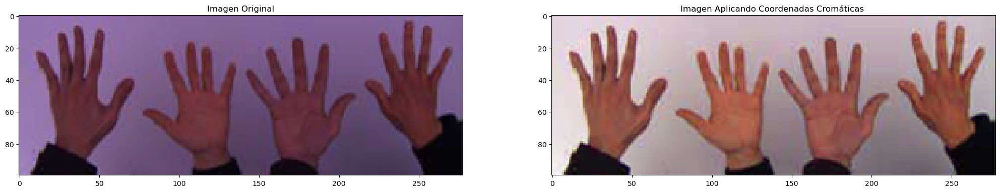

<Figure size 640x480 with 0 Axes>

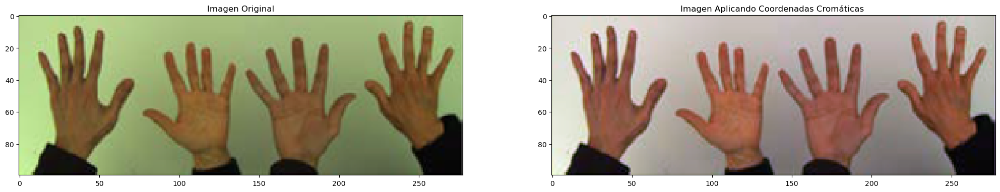

<Figure size 640x480 with 0 Axes>

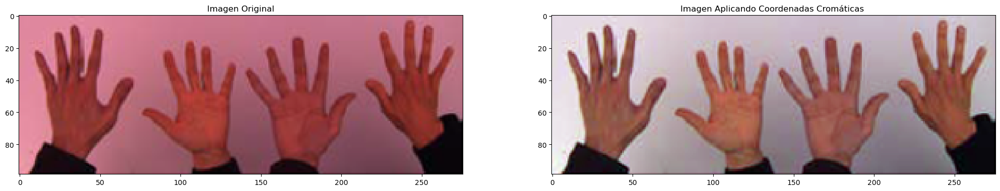

In [15]:
white_patch = img_to_white_patch()

white_patch.load_img(img_white_patch_1)
white_patch.convert()

white_patch.load_img(img_white_patch_2)
white_patch.convert()

white_patch.load_img(img_white_patch_3)
white_patch.convert()

#### 📑 Conclusiones 1 

Como podemos observar en cada una de las imagenes de las manos cargadas, logramos obtener en las tres aplicaciones resultados satisfactorios ya que se recuperan las manos haciendolas independiente del fondo en el que se encuentran.

#### 👽 Implentación de White Patch para 3 imagenes de Depredador

<Figure size 640x480 with 0 Axes>

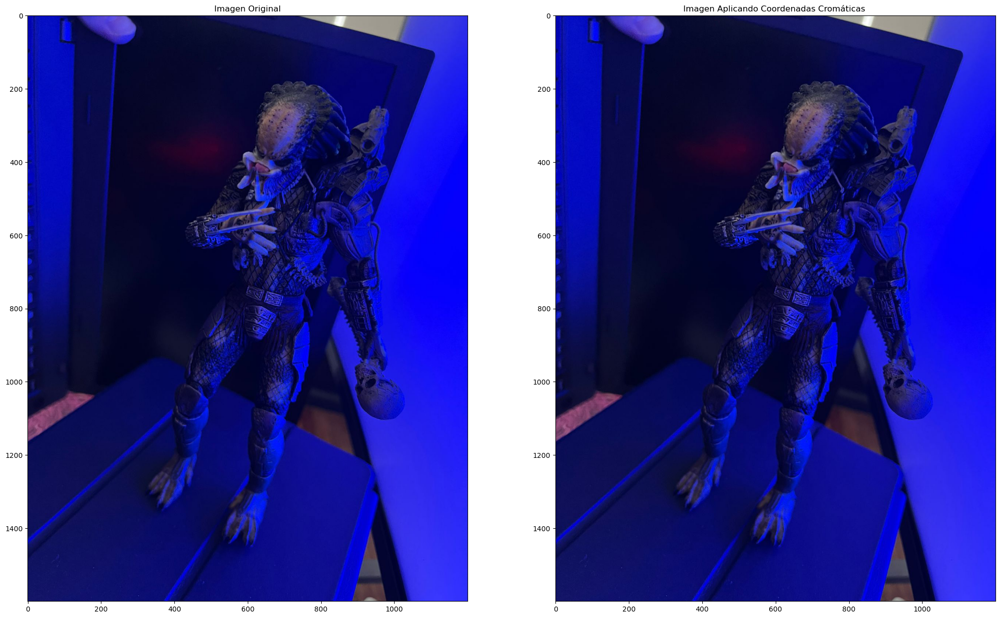

<Figure size 640x480 with 0 Axes>

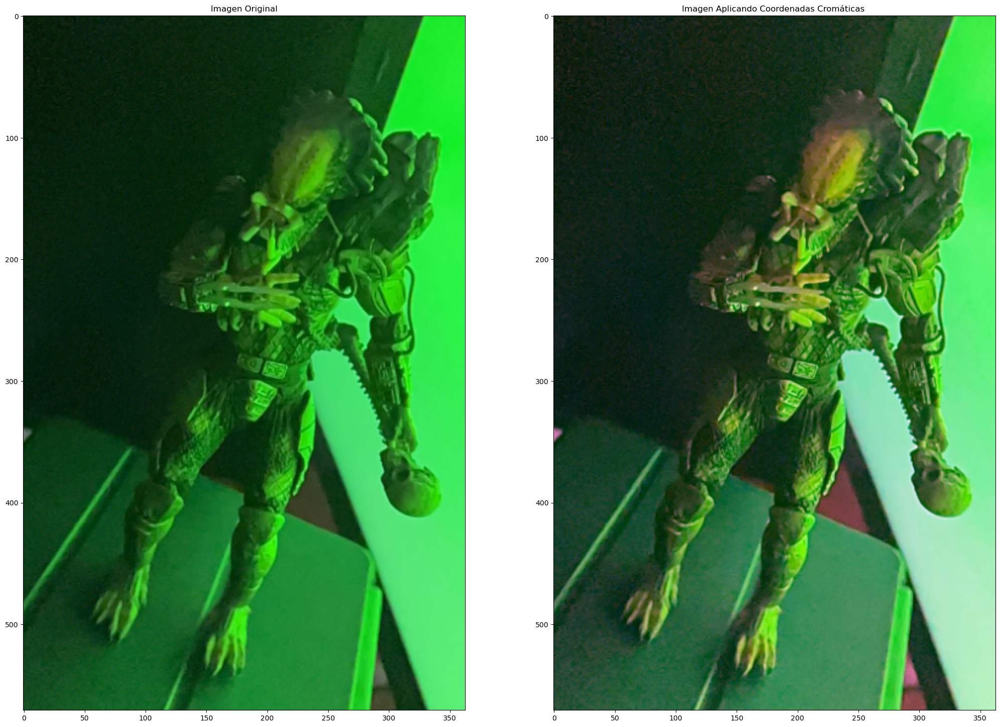

<Figure size 640x480 with 0 Axes>

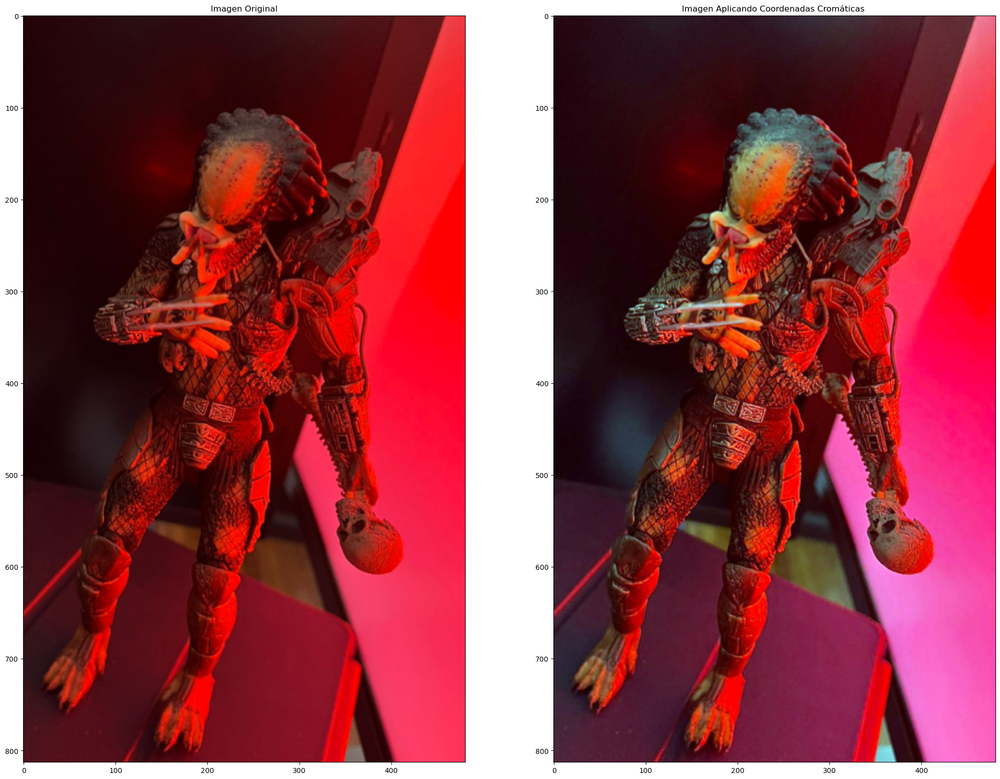

In [20]:
white_patch.load_img(img_white_patch_4)
white_patch.convert()

white_patch.load_img(img_white_patch_5)
white_patch.convert()

white_patch.load_img(img_white_patch_6)
white_patch.convert()

#### 📑 Conclusiones 2 

Se puede observar que se logra recuperar algo del color del muñeco en las imagenes con iluminacion verde y roja, pero no asi en la imagen con iluminacion azul. Esto se puede deber a que en la formula de aplicacion, los valores maximos de los pixeles de los canales son cercanos a 255 y por lo tanto la division que se implementa por canal es cercana a 1 lo que no genera cambios en la imagen resultante. 

Mas alla de lo antes mencionado, se pudo corroborar el funcionamiento del metodo White Patch principalmente en la imagen con iluminacion roja.

#### 👽 Implentación de White Patch para 2 imagenes de Depredador

<Figure size 640x480 with 0 Axes>

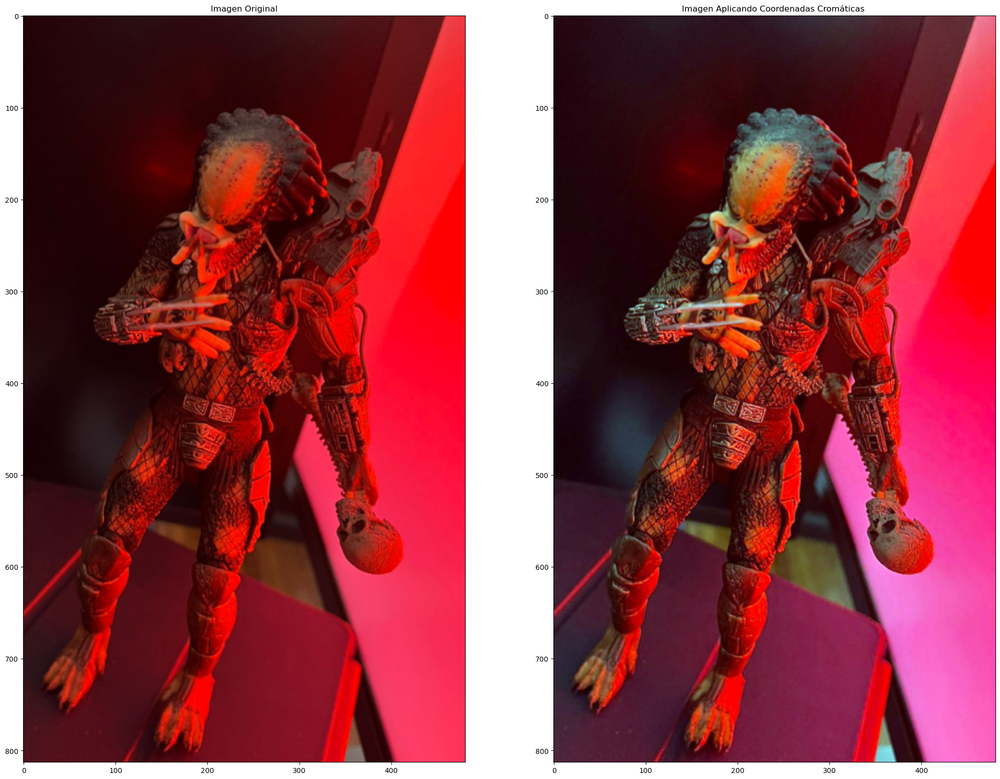

<Figure size 640x480 with 0 Axes>

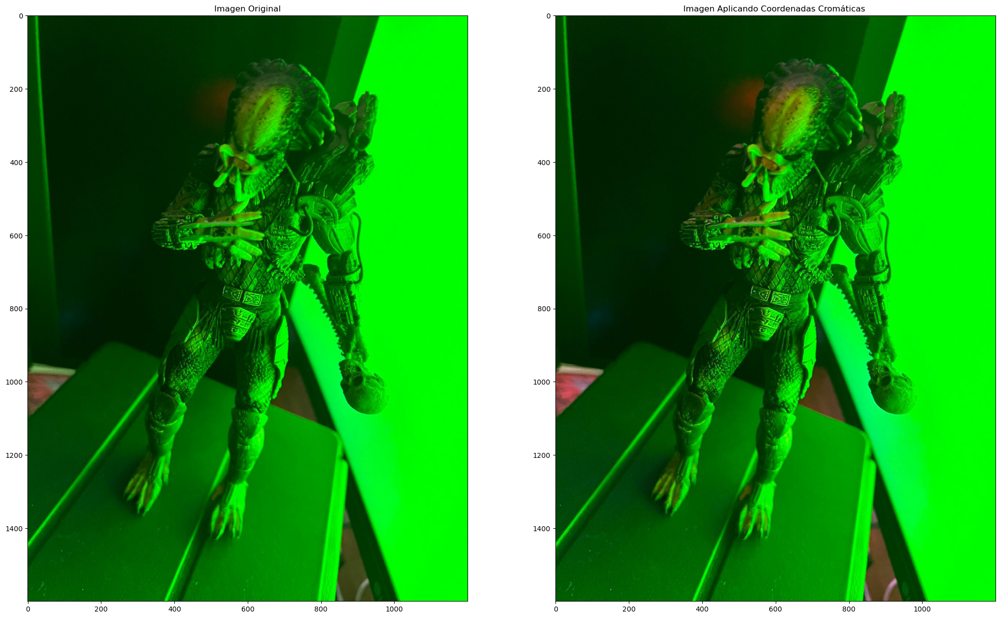

In [22]:
white_patch.load_img(img_white_patch_6)
white_patch.convert()

white_patch.load_img(img_white_patch_7)
white_patch.convert()

#### 📑 Conclusiones 3 

Similar al analisis anterior, podemos ver como en la imagen que contiene un nivel medio/alto de iluminacion roja podemos recuperar ciertos puntos de color de la imagen original, no asi con la imagen donde tenemos una fuerte iluminacion verde en toda la imagen, haciendo que el algoritmo no sea eficiente para su aplicacion. 